In [1]:
import cv2  
import math
import matplotlib.pyplot as plt 
import numpy as np

from scipy import signal

### Convolution vs Correlation

#### Correlation

Applying a filter to an image. To apply a filter to an image, the filter is "placed" over each image pixel. Elements of the filter are multiplied element wise, and summed up.

Borders can be dealt with padding, either by mirroring, filling with border rows/columns, or setting extra elements to a constant.

The operation is:

- Translational invariant: its result is not dependent on the pixel location
- Local:  the result is only dependent on the neighborhood of the pixel

$F * I(x,y) = \sum\limits_{j = -N/2}^{N/2}\sum\limits_{i = -N/2}^{N/2} F(i,j) \times I(x+i, y+i)$

#### Convolution

It operates similarly to correlation. The main difference is how the filter is applied. For 2D images the filter is flipped both vertically and horizontally, or alternatively rotated by 180 degrees.

$F * I(x,y) = \sum\limits_{j = -N/2}^{N/2}\sum\limits_{i = -N/2}^{N/2} F(i,j) \times I(x-i, y-i)$

The formula above handles this kernel rotation. Another option is to previously rotate the kernel, and then apply a correlation.

For symmetrical filters convolution is equivalent to correlation.


In [2]:
def correlate(i,j, kernel, image):

    res = 0
    for ii in range(i-1,i+2):
        for jj in range(j-1, j+2):
            res += image[ii][jj] * kernel[ii-i+1][jj-j+1]

    return res

Correlation = Convolution for symmetrical filters

In [3]:

kernel = [[1,2,3],
          [4,5,6],
          [7,8,9]]

image = np.zeros((5,5)) 
image[2][2] = 1

print(image)

sub = [[ correlate(i,j, kernel, image) for j in range(1,4)] for i in range(1,4)]

print (sub)

[[0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]]
[[9.0, 8.0, 7.0], [6.0, 5.0, 4.0], [3.0, 2.0, 1.0]]


In [4]:
kernel2 = np.rot90(kernel,2)
print(kernel2)

sub = [[ correlate(i,j, kernel2, image) for j in range(1,4)] for i in range(1,4)]

print (sub)

[[9 8 7]
 [6 5 4]
 [3 2 1]]
[[1.0, 2.0, 3.0], [4.0, 5.0, 6.0], [7.0, 8.0, 9.0]]


#### Compose kernels

In [5]:

a=np.asarray([[-1,0,1],
              [-2,0,2],
              [-1,0,1]])

print(np.rot90(a,2))              

b=np.asarray([[-1,0,1],
              [-2,0,2],
              [-1,0,1]])

print(signal.convolve2d(b, a, boundary='fill', fillvalue=0))

[[ 1  0 -1]
 [ 2  0 -2]
 [ 1  0 -1]]
[[  1   0  -2   0   1]
 [  4   0  -8   0   4]
 [  6   0 -12   0   6]
 [  4   0  -8   0   4]
 [  1   0  -2   0   1]]


### Init

Load, resize and show image

(1080, 1920, 3)
(270, 480, 3)


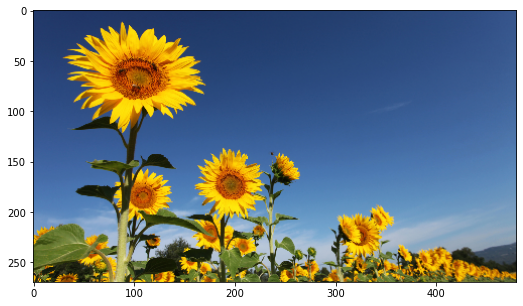

In [7]:
img = cv2.imread('images/pollination.jpg')
print(img.shape)
img = cv2.resize(img, (int(img.shape[1]/4), int(img.shape[0]/4)))
print(img.shape)
fig = plt.figure(figsize=(15,5))
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))


### The identity filter



In [8]:
dim = 3
kernel = np.zeros((dim,dim))
kernel[int(dim/2)][int(dim/2)] = 1
print(kernel)

[[0. 0. 0.]
 [0. 1. 0.]
 [0. 0. 0.]]


### A simple filter

What does it do?

In [9]:
dim = 30
kernel = np.zeros((dim,dim))
kernel[int(dim-1)][int(dim-1)] = 1

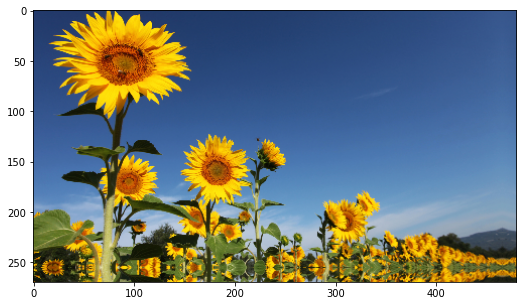

In [10]:
res = cv2.filter2D(img, -1, kernel)
fig = plt.figure(figsize=(15,5))
plt.imshow(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

### Motion blur

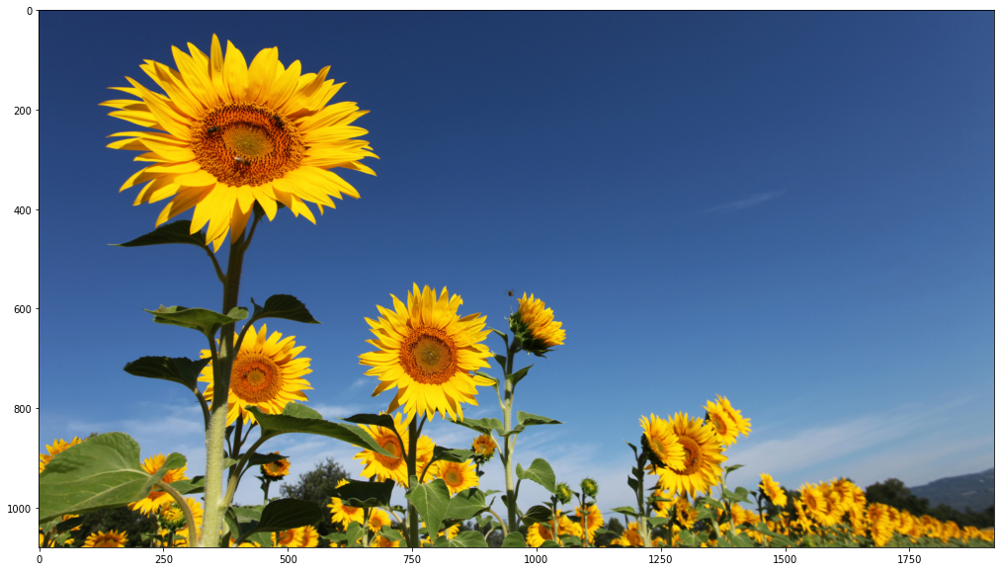

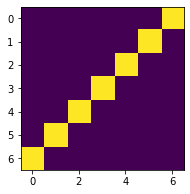

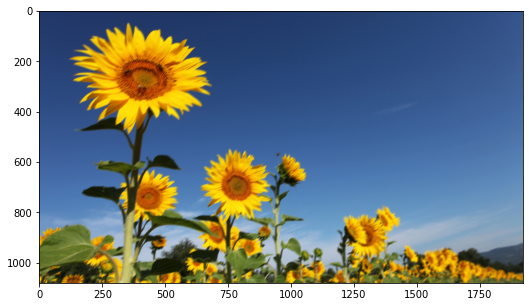

In [14]:
# https://unsplash.com/@stefantakespictures
car1 = cv2.imread('images/pollination.jpg')
fig = plt.figure(figsize=(30,10))
plt.imshow(cv2.cvtColor(car1, cv2.COLOR_BGR2RGB))

kernel = np.array([
    [ 0, 0, 0, 0, 0, 0, 1],
    [ 0, 0, 0, 0, 0, 1, 0],
    [ 0, 0, 0, 0, 1, 0, 0],
    [ 0, 0, 0, 1, 0, 0, 0],
    [ 0, 0, 1, 0, 0, 0, 0],
    [ 0, 1, 0, 0, 0, 0, 0],
    [ 1, 0, 0, 0, 0, 0, 0]
   ]
)
kernel = kernel/np.sum(kernel)
fig = plt.figure(figsize=(3,3))
plt.imshow(kernel)

res = cv2.filter2D(car1, -1, kernel)
fig = plt.figure(figsize=(15,5))
plt.imshow(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

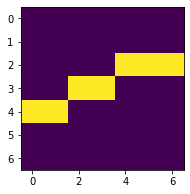

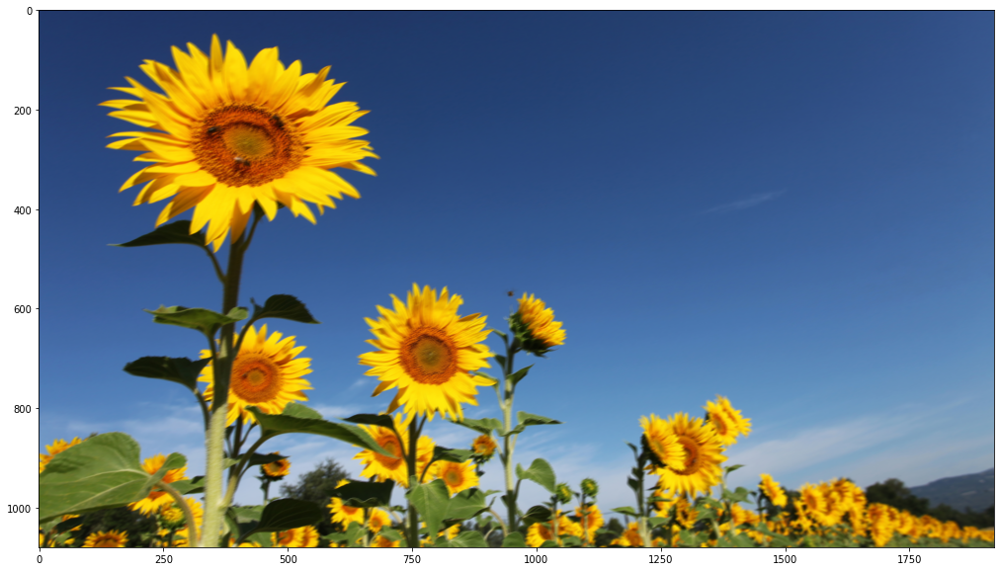

In [15]:
kernel = np.array([
    [ 0, 0, 0, 0, 0, 0, 0],
    [ 0, 0, 0, 0, 0, 0, 0],
    [ 0, 0, 0, 0, 1, 1, 1],
    [ 0, 0, 1, 1, 0, 0, 0],
    [ 1, 1, 0, 0, 0, 0, 0],
    [ 0, 0, 0, 0, 0, 0, 0],
    [ 0, 0, 0, 0, 0, 0, 0]
   ]
)
kernel = kernel/np.sum(kernel)
fig = plt.figure(figsize=(3,3))
plt.imshow(kernel)


resV = cv2.filter2D(car1, -1, kernel)
fig = plt.figure(figsize=(30,10))
plt.imshow(cv2.cvtColor(resV, cv2.COLOR_BGR2RGB))

### Box Filter

In [21]:
dim = 20
kernel = np.ones((dim,dim))
kernel = kernel / np.sum(kernel)
res = cv2.filter2D(img, -1, kernel)

print(kernel)

[[0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025
  0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025]
 [0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025
  0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025]
 [0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025
  0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025]
 [0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025
  0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025]
 [0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025
  0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025]
 [0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025
  0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025]
 [0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025
  0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 0.0025 

#### Note

- To avoid altering the brightness of the image the sum of the kernel elements must be 1

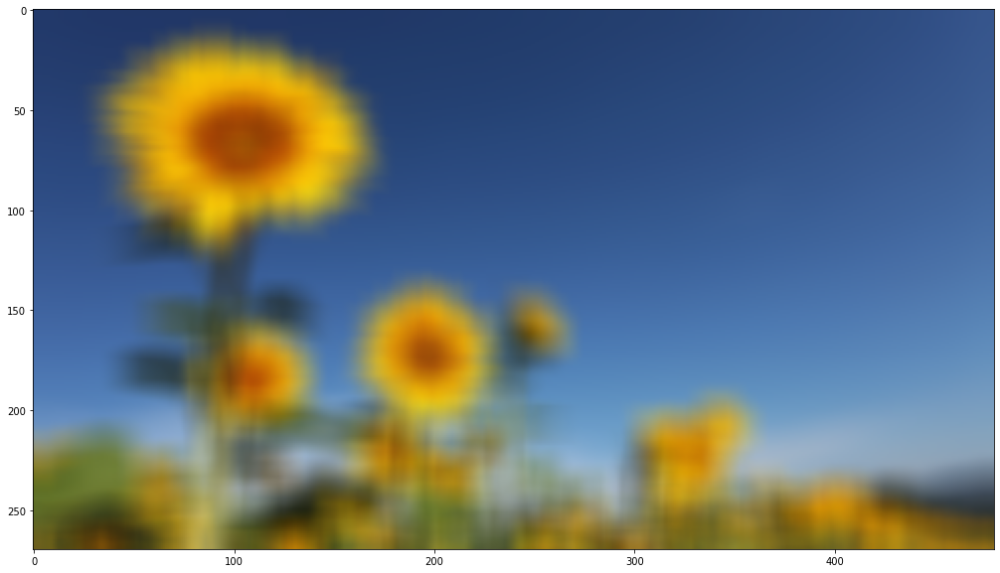

In [23]:
fig = plt.figure(figsize=(30,10))
plt.imshow(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

### Gaussian Blur

$n_\sigma [i,j] = \Large\frac{1}{2\pi\sigma^2} e^{(\Large\frac{i^2 + j^2}{2 \sigma^2})}$




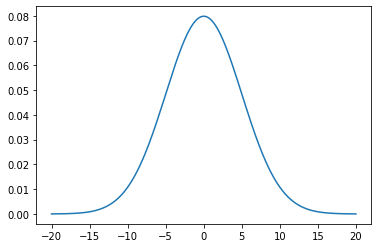

In [24]:
# considering the mean to be zero

def gaussian(std):

    weight = 1 / (std * pow(2 * math.pi, 0.5))
    limits = 20
    start = -limits
    end = limits
    step = 0.01
    r = np.arange(start,end, step)
    x = np.arange(start,end, step)
    kernel = [weight * math.exp((-pow(-r[i],2))/(2 * pow(std,2))) for i in range(int((end-start)/step))] 

    return kernel, r

kernel,r  = gaussian(5)
plt.plot(r, kernel)

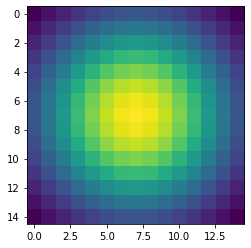

In [25]:
def gaussian_kernel(dimension, std):

    weight = 1 / (2 * math.pi * pow(std,2))
    start = -int(dimension * 0.5)
    end = int(dimension*0.5)

    kernel = [[weight * math.exp(-0.5*(pow(i,2)+pow(j,2))/pow(std,2)) for i in range(start,end+1)] for j in range(start,end+1)]

    return kernel

kernel = gaussian_kernel(15,5)
plt.imshow(kernel)


Must relate $\sigma$ with kernel dimension

In a normal distribution $99.73\%$ of the values are within 3 standard deviations from the mean.

- $\sigma =  \frac{dimension}{2 \pi}$

- cv2 formula: $\sigma = 0.3*((dimension-1)*0.5 - 1) + 0.8$



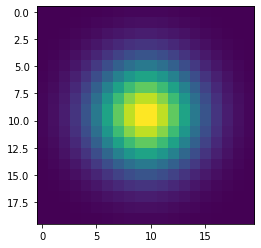

In [28]:
# getGaussianKernal second parameter is sigma. Setting it to -1 lets OpenCV compute it

def gaussian_kernel(dimension):
    #sigma = 0.3*((dimension-1)*0.5 - 1) + 0.8
    sigma = dimension/(2*math.pi)
    x = cv2.getGaussianKernel(dimension, -1)
    kernel = x.dot(x.T)
    return kernel

kernel = gaussian_kernel(20)
plt.imshow(kernel)

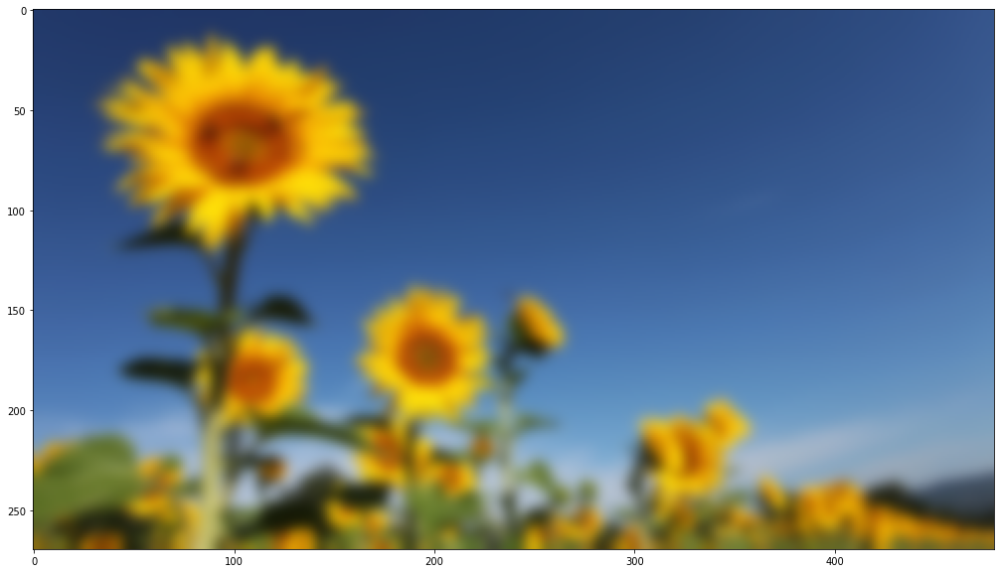

In [29]:
res = cv2.filter2D(img, -1, kernel) 
fig = plt.figure(figsize=(30,10))
plt.imshow(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

### Separable filters

If a filter can be decomposed a product of two filters, then it is separable

- Much faster computation!

- for instance, the Gaussian filter is separable

Normal filtering $n\times n$ involves $n^2$ multiplications

Filtering only per row (or column) requires $n$ multiplications $=>$ total filtering requires $2n$ multiplications


#### Gaussian Kernel Separability

$F = G_{XY} * I = G_{X} * G_{Y} * I = G_{X} * (G_{Y} * I $)

(1, 7) [[0.00953734 0.07148014 0.23935377 0.35808975 0.23935377 0.07148014
  0.00953734]]
0.9976658827988816


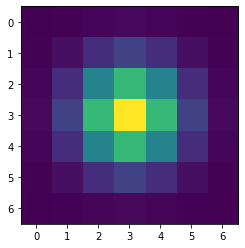

In [30]:

dim = 3 ## kernel dimension = 2 * dim +1
std = (2*dim+1)/(2*math.pi)
weight = 1 / (std * pow(2 * math.pi, 0.5))
kernel = np.asarray([[weight * math.exp((-pow(-i,2))/(2 * pow(std,2))) for i in range(-dim, dim+1)]])

print(kernel.shape, kernel)              

k = signal.convolve2d(kernel.T, kernel, boundary='fill', fillvalue=0)
plt.imshow(k)
print(np.sum(k))

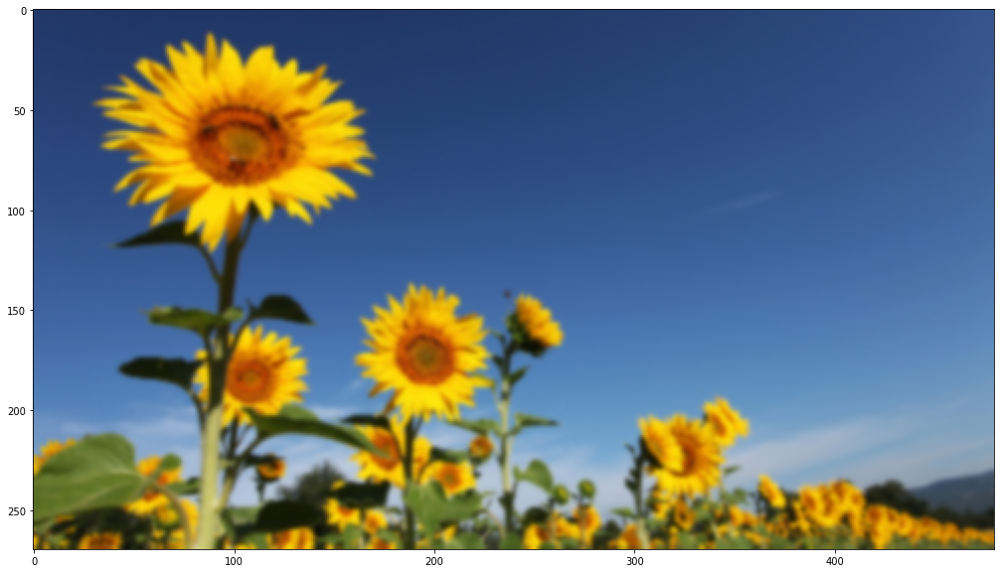

In [31]:
res1 = cv2.filter2D(img, -1, kernel.T) 
res2 = cv2.filter2D(res1, -1, kernel)
fig = plt.figure(figsize=(30,10))
#plt.imshow(cv2.cvtColor((res2*np.float32(1/np.sum(k))).astype(np.uint8), cv2.COLOR_BGR2RGB))
plt.imshow(cv2.cvtColor(res2, cv2.COLOR_BGR2RGB))

### Sharpening

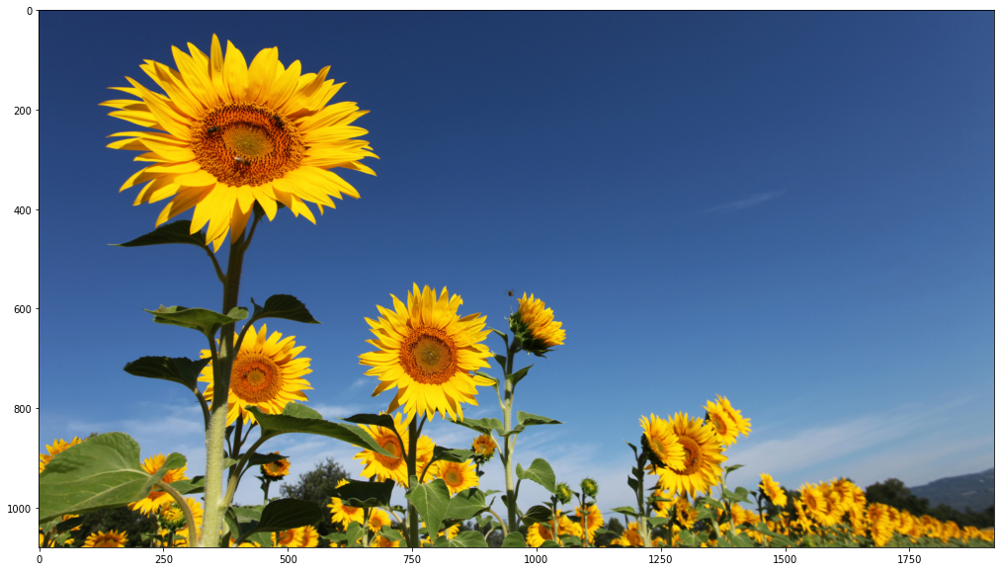

In [34]:
img2 = cv2.imread('images/pollination.jpg')
fig = plt.figure(figsize=(30,10))
plt.imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB))


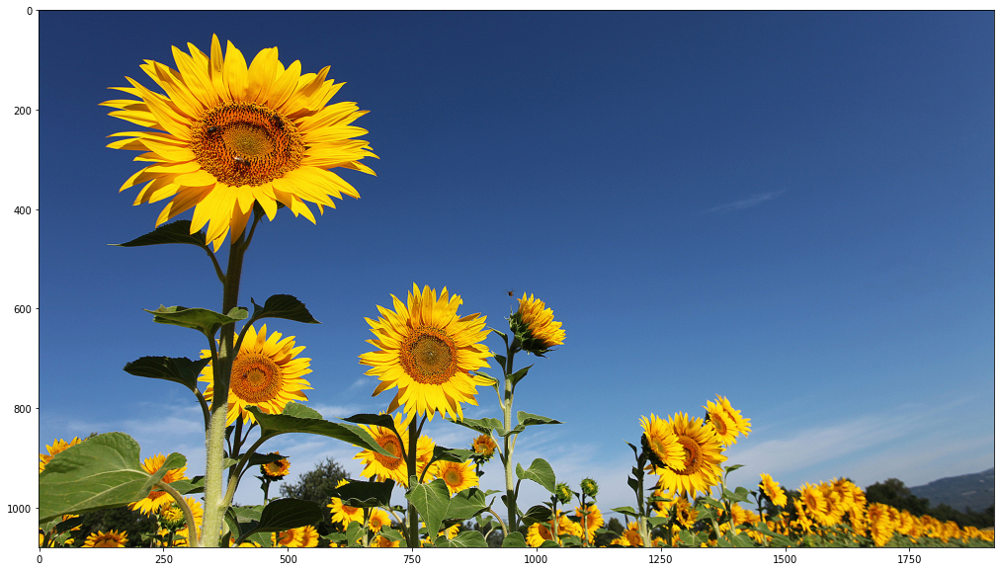

In [35]:
kernel = np.array([
    [ 0, -1,  0],
    [-1,  5, -1],
    [ 0, -1,  0]]
)

#normalize kernel
kernel = kernel / np.sum(kernel)
res = cv2.filter2D(img2, -1, kernel)
fig = plt.figure(figsize=(30,10))
plt.imshow(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

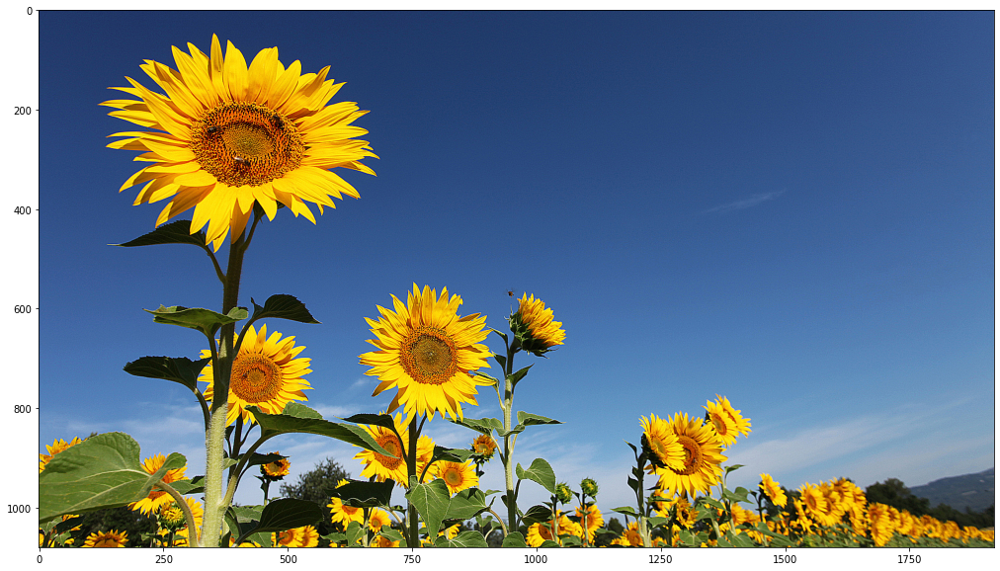

In [44]:
kernel = np.array([
    [ -1, -1, -1],
    [ -1,  10, -1],
    [ -1, -1, -1]]
)

#normalize kernel
kernel = kernel / np.sum(kernel)

res = cv2.filter2D(img2, -1, kernel)
fig = plt.figure(figsize=(30,10))
plt.imshow(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

### Emboss

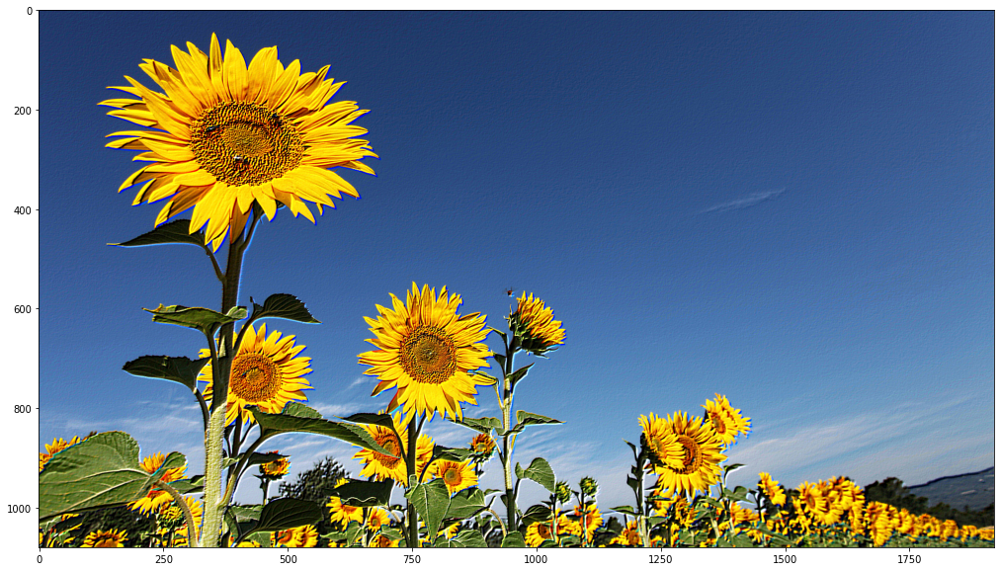

In [45]:
kernel = np.array([
    [ -2, -1, 0],
    [ -1,  1, 1],
    [  0,  1, 2]]
)

#normalize kernel
kernel = kernel / np.sum(kernel)

res = cv2.filter2D(img2, -1, kernel)
fig = plt.figure(figsize=(30,10))
plt.imshow(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

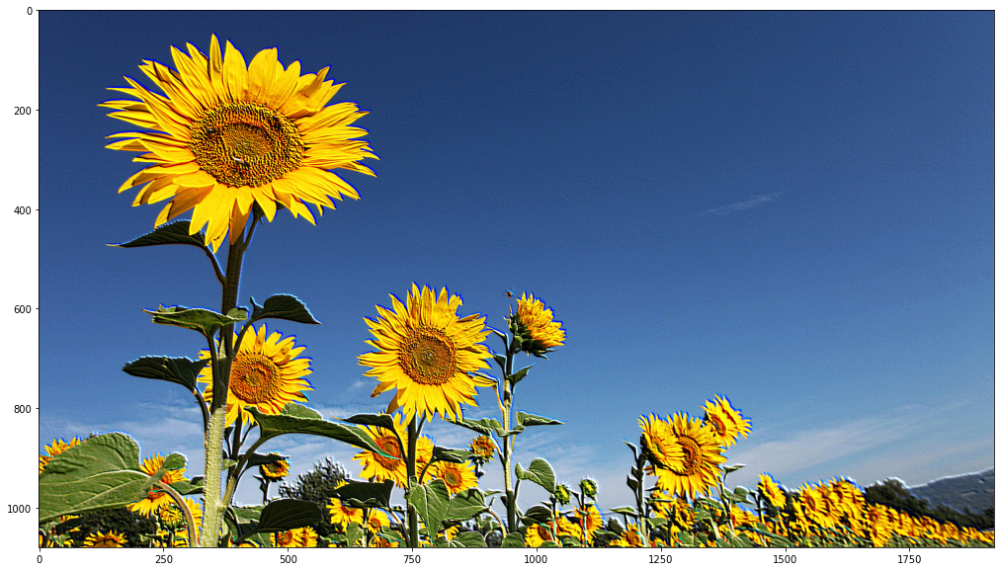

In [46]:
kernel = np.array([
    [  0,  1, 2],
    [ -1,  1, 1],
    [ -2, -1, 0]]
)

#normalize kernel
kernel = kernel / np.sum(kernel)

res = cv2.filter2D(img2, -1, kernel)
fig = plt.figure(figsize=(30,10))
plt.imshow(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

### What happens if we don't make the sum of the kernel elements to 1?

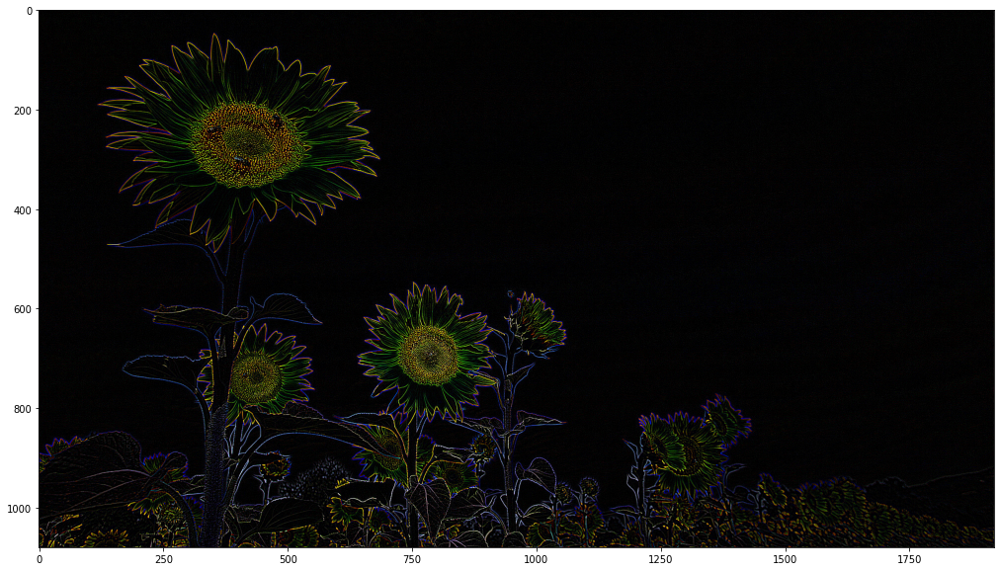

In [55]:
kernel = np.array([
    [ 1,  1, 1],
    [ 1, -8, 1],
    [ 1,  1, 1]]
)

kernel = np.array([
    [ -1, -1, -1],
    [ -1,  8, -1],
    [ -1, -1, -1]]
)
#normalize kernel
#kernel = kernel / np.sum(kernel)

res = cv2.filter2D(img2, -1, kernel)
fig = plt.figure(figsize=(30,10))
plt.imshow(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

### Edge detection

Edge detection filters use derivatives to compute edges

Derivatives are approximated based on central diferencing

$f(x) = f(x+1) - f(x-1)$

Note: we droped the division by $2$ since it only introduces a scale factor

Kernel for derivatives in the X direction = $[1, 0, -1]$

In [51]:
imgbw = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
imgbw = cv2.resize(imgbw, (int(imgbw.shape[1]/2), int(imgbw.shape[0]/2)))
print(imgbw.shape)

(540, 960)


In [52]:
kernel = np.array([-1, 0, 1])

def apply_kernelV(image, kernel, i,j):
    return image[i-1][j]*kernel[0] + image[i][j]*kernel[1] + image[i+1][j]*kernel[2]

def apply_kernelH(image, kernel, i,j):
    return image[i][j-1]*kernel[0] + image[i][j]*kernel[1] + image[i][j+1]*kernel[2]


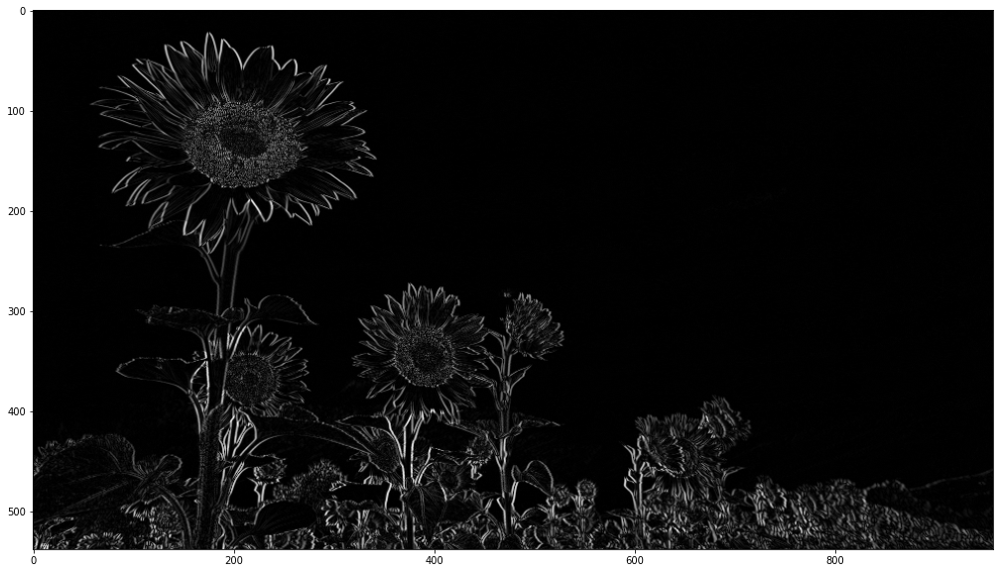

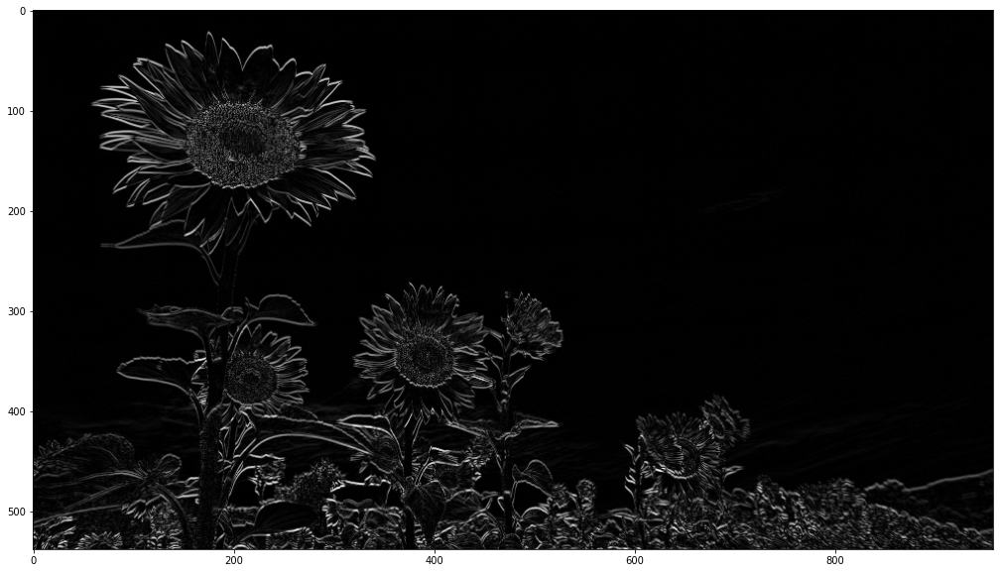

In [53]:
res = [[apply_kernelH(imgbw, kernel, i,j) for j in range(1, imgbw.shape[1]-1) ] for i in range(1, imgbw.shape[0]-1)]

fig = plt.figure(figsize=(30,10))
plt.imshow(np.abs(res), cmap='gray')


res = [[apply_kernelV(imgbw, kernel, i,j) for j in range(1, imgbw.shape[1]-1) ]for i in range(1, imgbw.shape[0]-1)]

fig = plt.figure(figsize=(30,10))
plt.imshow(np.abs(res), cmap='gray')

Same principle but with cv2 *filter2D* function

Note that *filter2D* caps the result to [0,255]

- this implies that negatives values appear as black and not as edges (white)

0
0


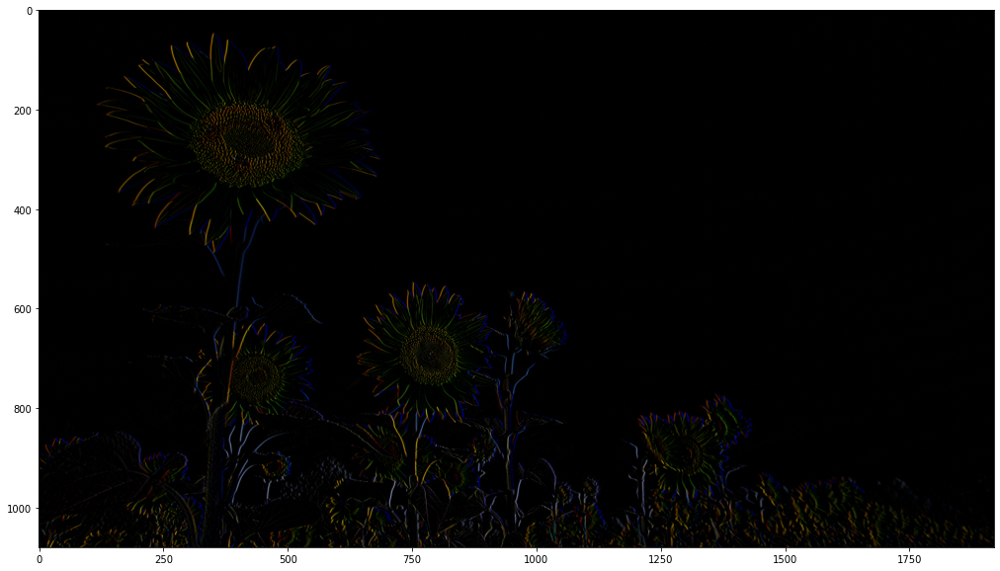

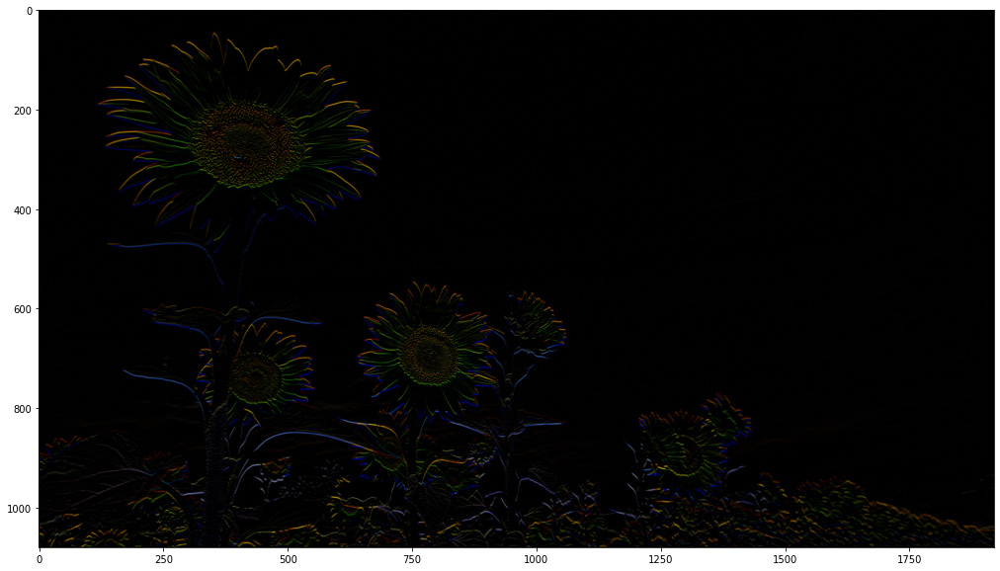

In [56]:
# along X direction
kernel = np.array([[-1, 0, 1]])

resH = cv2.filter2D(img2, -1, kernel)
print(np.min(resH))

fig = plt.figure(figsize=(30,10))
plt.imshow(cv2.cvtColor(resH, cv2.COLOR_BGR2RGB))

# along Y direction
kernel = np.array([[-1], [0], [1]])

resV = cv2.filter2D(img2, -1, kernel)
print(np.min(resV))

fig = plt.figure(figsize=(30,10))
plt.imshow(cv2.cvtColor(resV, cv2.COLOR_BGR2RGB))

### Prewit

Prewit is an edge detection filter that computes central differencing to compute image derivatives.

It first computes a smoothed image to remove noise, hence avoiding some false edges


$ K_x = \begin{bmatrix} 1 \\ 1 \\ 1\end{bmatrix} \times \begin{bmatrix} -1 & 0 & 1\end{bmatrix}  = \begin{bmatrix} -1 & 0 & 1 \\ -1 & 0 & 1 \\ -1 & 0 & 1 \end{bmatrix}$

Note that, for the derivative in the $x$ direction we compute the smoothing in the $y$ direction!

$K_y =  \times \begin{bmatrix} 1 & 1 & 1\end{bmatrix} \begin{bmatrix} -1 \\ 0 \\ 1\end{bmatrix}= \begin{bmatrix} -1 & -1 & -1 \\ 0 & 0 & 0 \\ 1 & 1 & 1 \end{bmatrix}$

$R_x = K_x \times I \\ R_y = K_y \times I$

$Final = \sqrt{R_x^2 + R_y^2}$



0


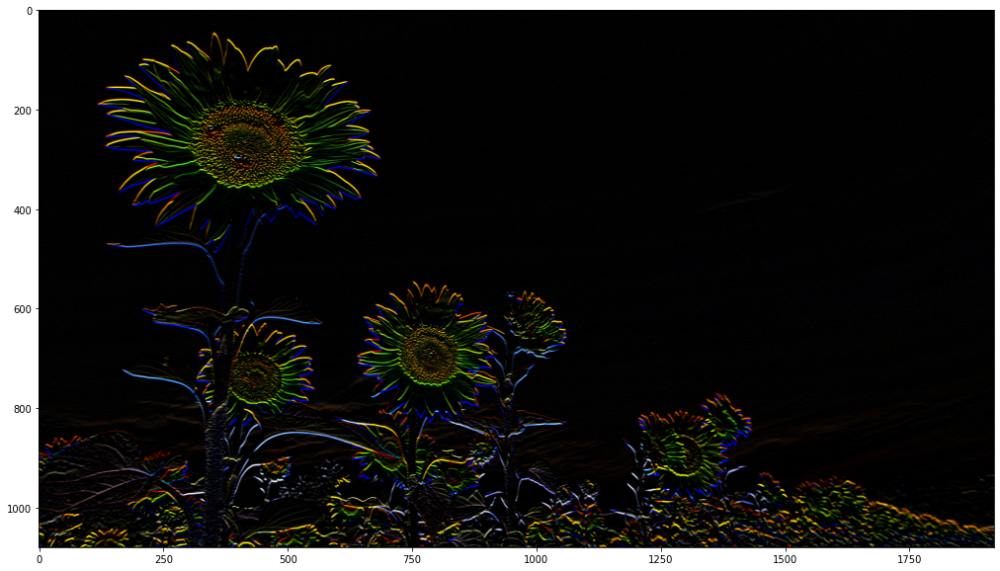

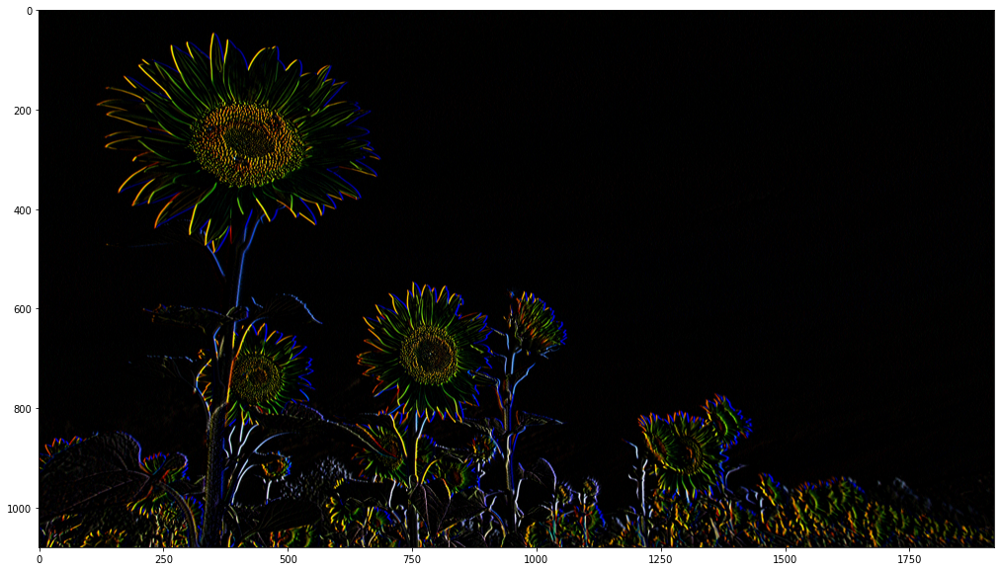

In [58]:
#show symmetric filter (CV does cap values to [0, 255])

kernel = np.array([
    [ -1, -1, -1],
    [  0,  0,  0],
    [  1,  1,  1]]
)

resH = cv2.filter2D(img2, -1, kernel)
print(np.min(resH))
fig = plt.figure(figsize=(30,10))
plt.imshow(cv2.cvtColor(resH, cv2.COLOR_BGR2RGB))

kernel = np.array([
    [ -1, 0, 1],
    [ -1, 0, 1],
    [ -1, 0,1]]
)

#normalize kernel
#kernel = kernel / np.sum(kernel)

resV = cv2.filter2D(img2, -1, kernel)
fig = plt.figure(figsize=(30,10))
plt.imshow(cv2.cvtColor(resV, cv2.COLOR_BGR2RGB))

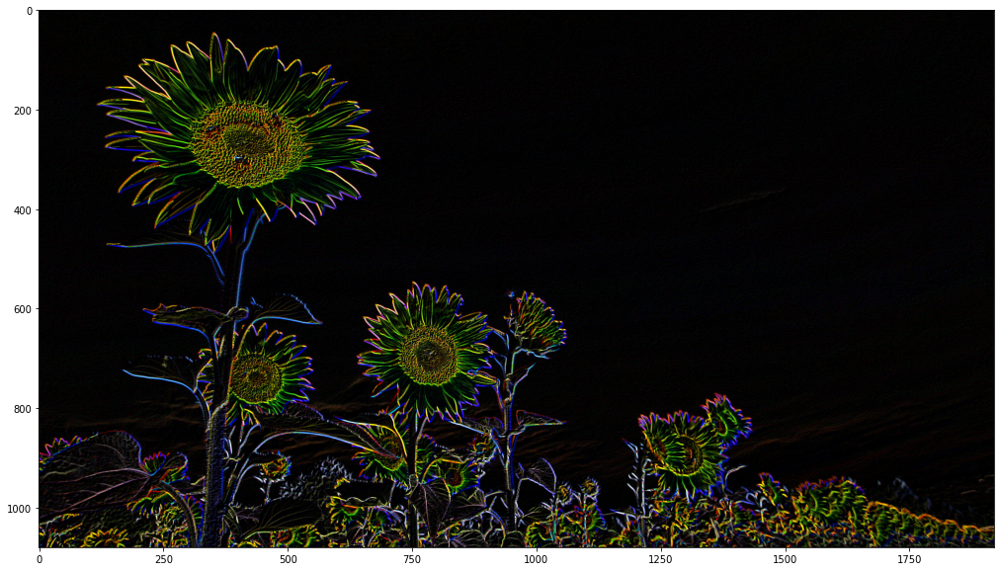

In [59]:
res = resH + resV
fig = plt.figure(figsize=(30,10))
plt.imshow(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

### Sobel

Sobel is similar to Prewit, but instead of performing linear smoothing it smooths with an approximate Gaussian.


$ K_x = \begin{bmatrix} 1 \\ 2 \\ 1\end{bmatrix} * \begin{bmatrix} -1 & 0 & 1\end{bmatrix}  = \begin{bmatrix} -1 & 0 & 1 \\ -2 & 0 & 2 \\ -1 & 0 & 1 \end{bmatrix}$

$K_y = \begin{bmatrix} -1 & -2 & -1 \\ 0 & 0 & 0 \\ 1 & 2 & 1 \end{bmatrix}$


### Scharr

"improved Sobel operator: more accurate gradient direction

$ K_x = \begin{bmatrix} 3 \\ 10 \\ 3\end{bmatrix} * \begin{bmatrix} -1 & 0 & 1\end{bmatrix}  = \begin{bmatrix} -3 & 0 & 3 \\ -10 & 0 & 10 \\ -3 & 0 & 3 \end{bmatrix}$

$K_y = \begin{bmatrix} -3 & -10 & -3 \\ 0 & 0 & 0 \\ 3 & 10 & 3 \end{bmatrix}$



0


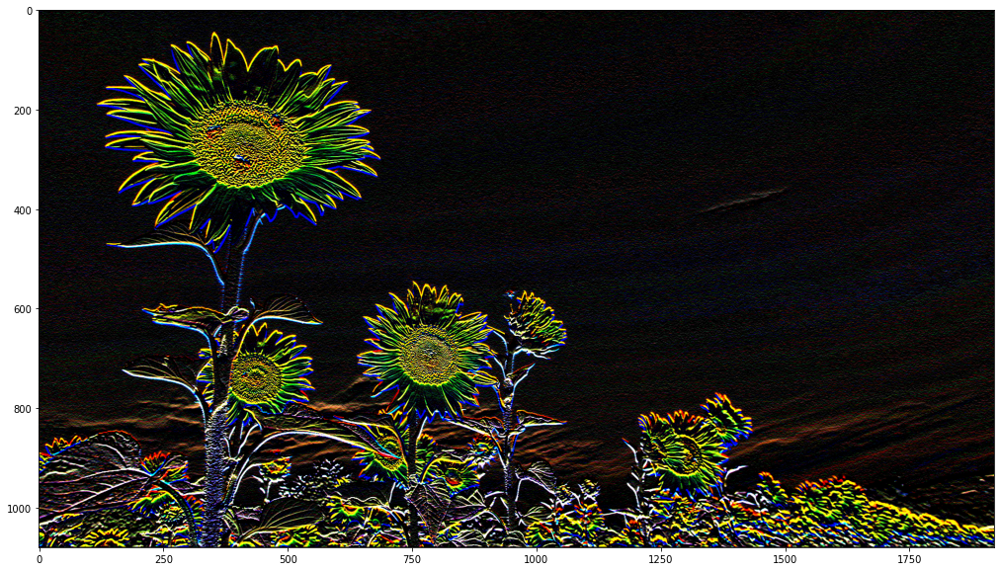

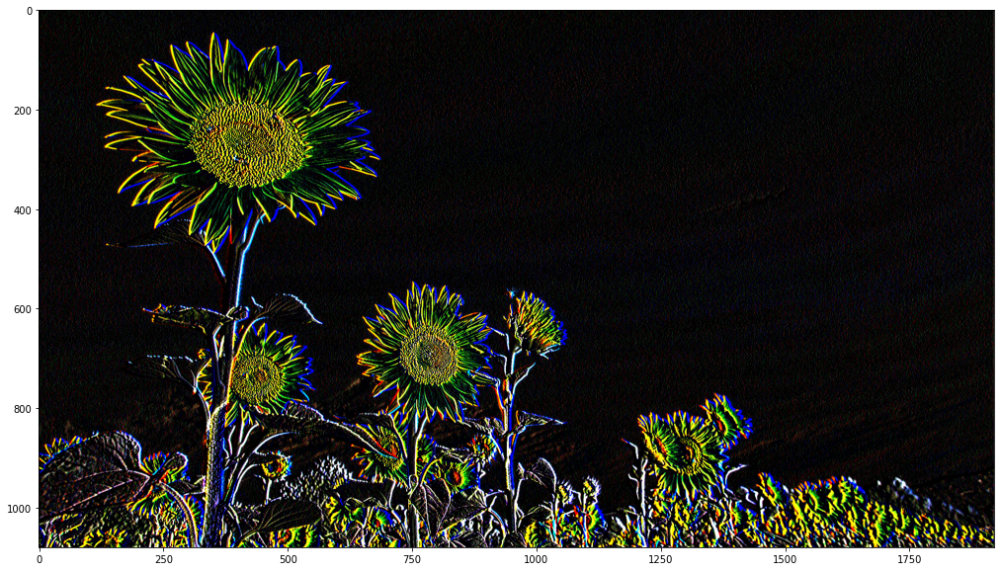

In [60]:
kernel = np.array([
    [ -3, -10, -3],
    [  0,   0,  0],
    [  3,  10,  3]]
)

resH = cv2.filter2D(img2, -1, kernel)
print(np.min(resH))
fig = plt.figure(figsize=(30,10))
plt.imshow(cv2.cvtColor(resH, cv2.COLOR_BGR2RGB))

kernel = np.array([
    [  -3, 0,  3],
    [ -10, 0, 10],
    [  -3, 0,  3]]
)

#normalize kernel
#kernel = kernel / np.sum(kernel)

resV = cv2.filter2D(img2, -1, kernel)
fig = plt.figure(figsize=(30,10))
plt.imshow(cv2.cvtColor(resV, cv2.COLOR_BGR2RGB))

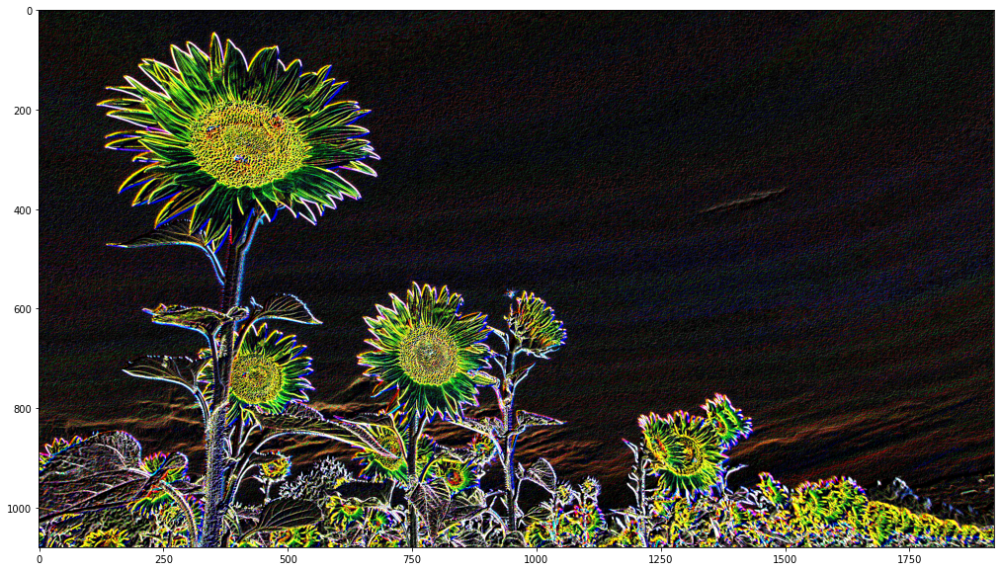

In [61]:
res = resH + resV
fig = plt.figure(figsize=(30,10))
plt.imshow(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

### Laplacian Edge detector

Steps:

- Gausssian smoothing to remove noise, hence remove "false" edges
- compute Laplacian of image 
- find zero-crossings

$F = l * g * I$

Note: $*$ denotes convolution

Due to the associativity property of convolutions:

$F = (l * g) * I$

$l * g = \nabla^2 g = LoG[x,y]= - \Large\frac{1}{\sqrt{2\pi}\sigma^3} \Large[ 2 - \Large\frac{x^2 + y^2}{\sigma^2}\Large] e^{- \Large\frac{x^2 + y^2}{2\sigma^2}}$

In practice:

- use Laplacian of Gaussian to compute second derivative of smoothed image
- find zero-crossings
- apply a threshold to remove noise

#### Apply Laplacian of Gaussian

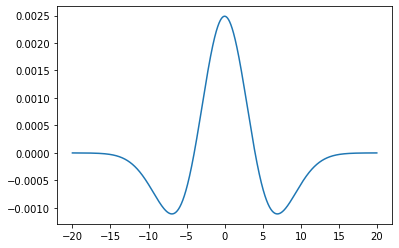

In [62]:
# computing second derivative of Gaussian (1-D)

# considering the mean to be zero

def gaussian(std):

    weight = 1 / (pow(std,3) * pow(2 * math.pi, 0.5))
    limits = 20
    start = -limits
    end = limits
    step = 0.01
    r = np.arange(start,end, step)
    x = np.arange(start,end, step)
    kernel = [(std*std - x[i]*x[i])/(pow(std,5)*2*math.pi) * math.exp((-x[i]*x[i])/(2 * std*std)) for i in range(int((end-start)/step))] 

    return kernel, r

kernel,r  = gaussian(4)
plt.plot(r, kernel)

[[-0.06996059 -0.17231423 -0.06996059]
 [-0.17231423  1.27323954 -0.17231423]
 [-0.06996059 -0.17231423 -0.06996059]]


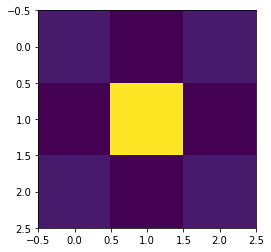

In [63]:
def LoG_kernel(dimension, std):

    weight = 1 / (2 * math.pi * pow(std,2))
    start = -int(dimension * 0.5)
    end = int(dimension*0.5)

    kernel = [[weight * (2 - (pow(i,2) + pow(j,2))/pow(std,2)) * math.exp((-i*i - j*j)/(2 * std*std)) for i in range(start,end+1)] for j in range(start,end+1)]

    return np.asarray(kernel)

kernel = LoG_kernel(3,0.5)
print(kernel)
plt.imshow(kernel)

#### Common Approximations

1057 -897


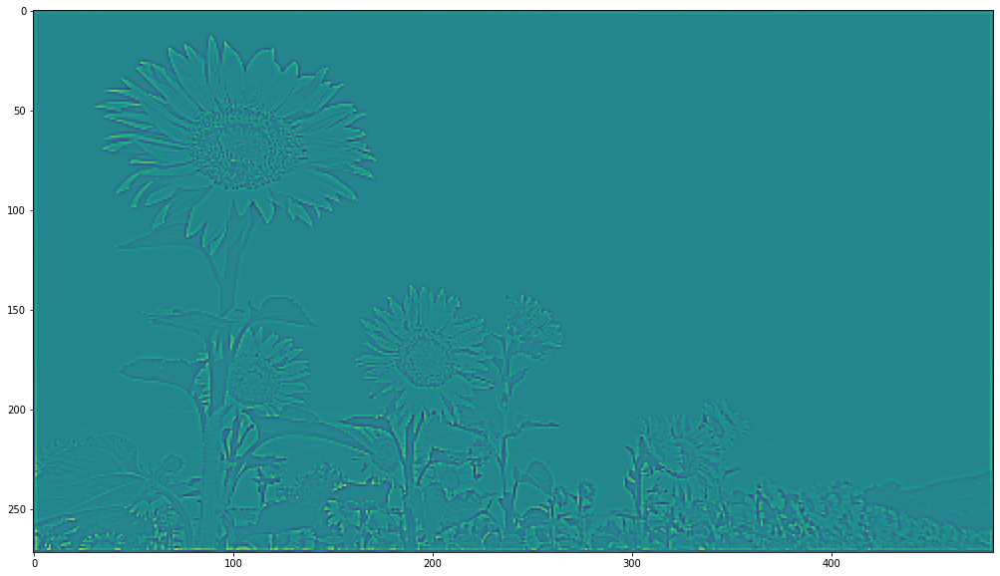

In [64]:
kernel = [[ 0, -1,  0],
          [-1,  4, -1 ],
          [ 0, -1,  0]]

kernel = [[ -1, -1,  -1],
          [ -1,  8,  -1 ],
          [ -1, -1,  -1]]          


res = signal.convolve2d(cv2.cvtColor(img, cv2.COLOR_BGR2GRAY), kernel)
print(np.max(res), np.min(res))

fig = plt.figure(figsize=(30,10))
plt.imshow(res)


#### Find zero-crossings


(270, 480)
2586


/tmp/ipykernel_5097/480275337.py:21: RuntimeWarning: divide by zero encountered in log10
  plt.imshow(np.log10(resZC))


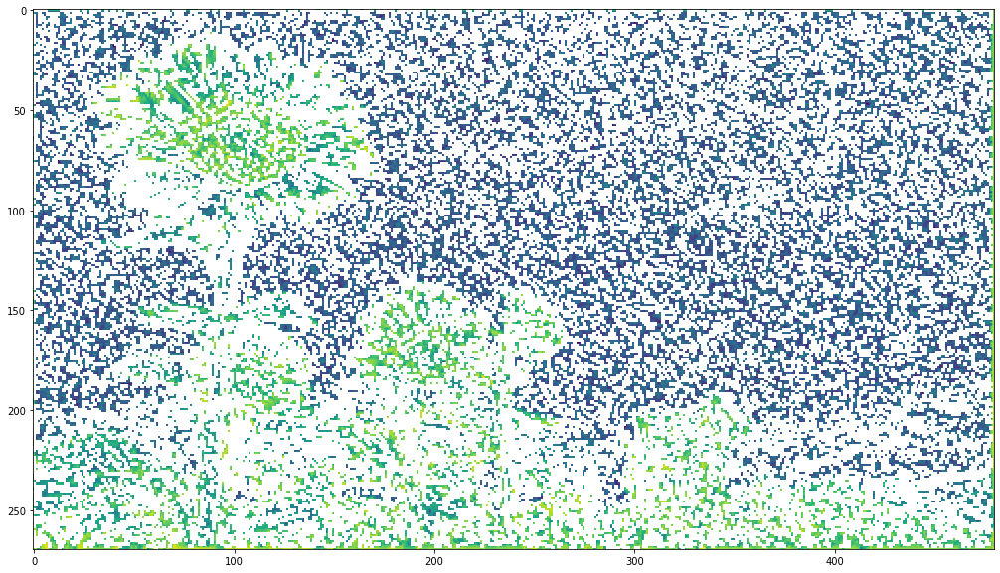

In [65]:

def find_zero_crossings(res):

    res = np.asarray(res)
    res2 = [[np.abs(res[i][j]-res[i+1][j])
                if (res[i][j] <= 0 and res[i+1][j] > 0) or (res[i][j] >= 0 and res[i+1][j] < 0)  else 0
                for j in range(1, res.shape[1]-1)] for i in range(1, res.shape[0]-1)]

    res3 =  [[np.abs(res[i][j]-res[i][j+1])
                if (res[i][j] <= 0 and res[i][j+1] > 0) or (res[i][j] >= 0 and res[i][j+1] < 0)  else 0
                for j in range(1, res.shape[1]-1)] for i in range(1, res.shape[0]-1)]

    res4 = np.asarray(res2)+np.asarray(res3)   
    print(res4.shape)   
    return (res4)

resZC = find_zero_crossings(res)

print(np.max(resZC))

fig = plt.figure(figsize=(30,10))
plt.imshow(np.log10(resZC))


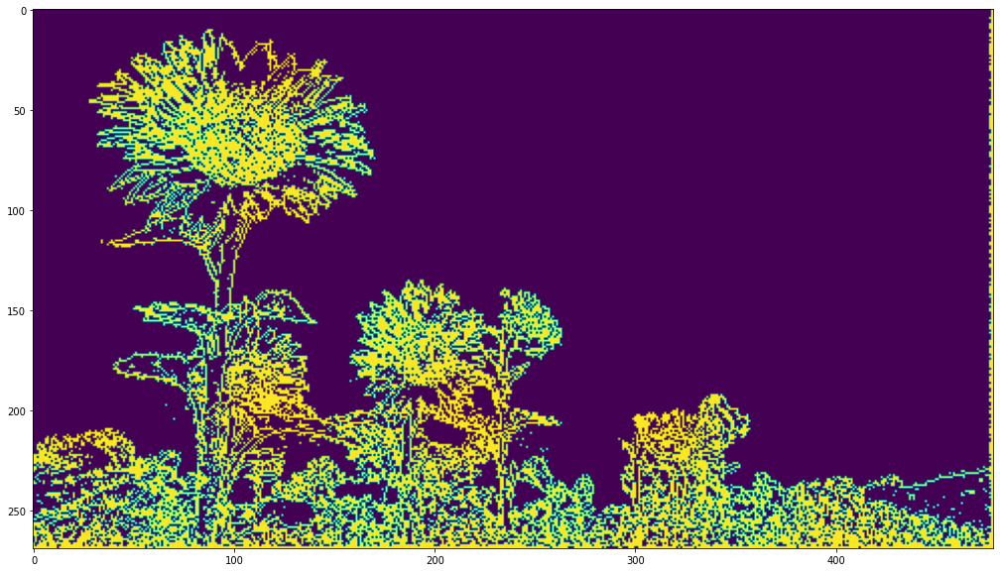

In [66]:
res2 = np.asarray(resZC)
res3 = [[1 if res2[i][j] > 80 else 0 for j in range(1, res2.shape[1])] for i in range(1, res2.shape[0])]
fig = plt.figure(figsize=(30,10))
plt.imshow(res3)

### Alternative View of Laplacian Edge Detector

$2^{nd}$ derivative of an image

$\Large\frac{\partial^2 f}{\partial x^2} = \Large\frac{\partial^2 }{\partial x^2}  * f = \Large(\frac{\partial }{\partial x} * \frac{\partial }{\partial x}) * f$

$\Large\frac{\partial }{\partial x} = \frac{f(x + \delta x) - f(x)}{\delta x}$

With discrete images $\delta x = 1$

$\Large\frac{\partial }{\partial x} = $ $\begin{bmatrix} 1, -1\end{bmatrix}$ Note: the order is due to the fact that this is a convolutional kernel, hence it will be flipped.

Computing the second derivative can be accomplished by applying the kernel twice

$\Large\frac{\partial^2 }{\partial x^2} = $ $\begin{bmatrix} 1, -1\end{bmatrix} * \begin{bmatrix} 1, -1\end{bmatrix} = \begin{bmatrix} -1, 2, -1\end{bmatrix}$

For the y axis we get:

$\Large\frac{\partial }{\partial y} = $ $\begin{bmatrix} 1 \\ -1\end{bmatrix}$

$\Large\frac{\partial^2 }{\partial y^2} = $ $\begin{bmatrix} 1 \\ -1\end{bmatrix} * \begin{bmatrix} 1 \\ -1\end{bmatrix} = \begin{bmatrix} -1 \\ 2 \\ -1\end{bmatrix}$

Applying the convolution to an approximate Gaussian Kernel:

$\Large\frac{\partial^2 }{\partial x^2}$ $ G = $ $ \begin{bmatrix} -1, 2, -1\end{bmatrix} * \begin{bmatrix} 1 \\ 2\\ 1\end{bmatrix} = \begin{bmatrix} -1, 2, -1 \\ -2, 4, -2\\-1, 2, -1\end{bmatrix}$

$\Large\frac{\partial^2 }{\partial y^2}$ $ G = $ $\begin{bmatrix} -1\\ 2\\ -1\end{bmatrix} * \begin{bmatrix} 1, 2, 1 \end{bmatrix} = \begin{bmatrix} -1, -2, -1 \\ 2, 4, 2\\-1, -2, -1\end{bmatrix}$











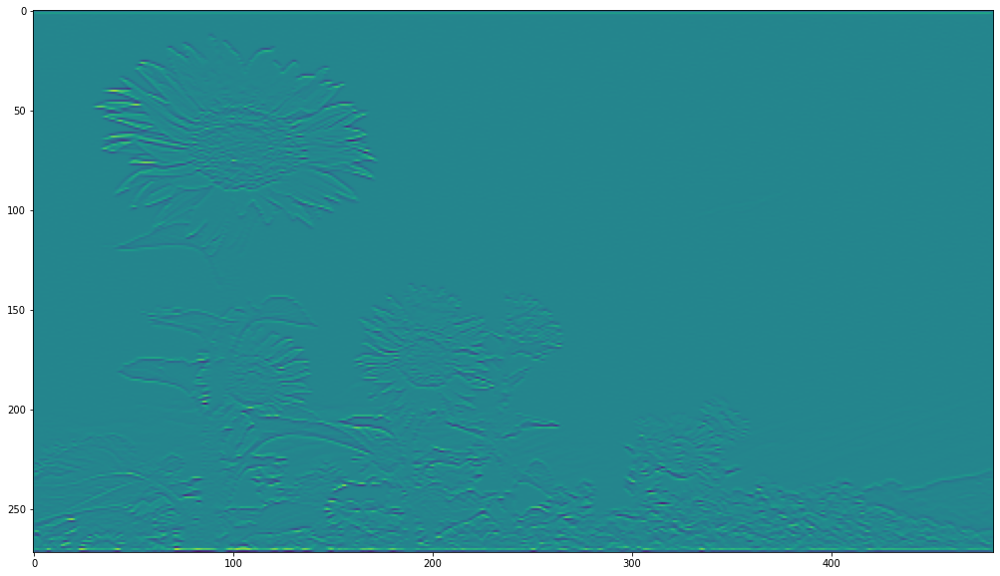

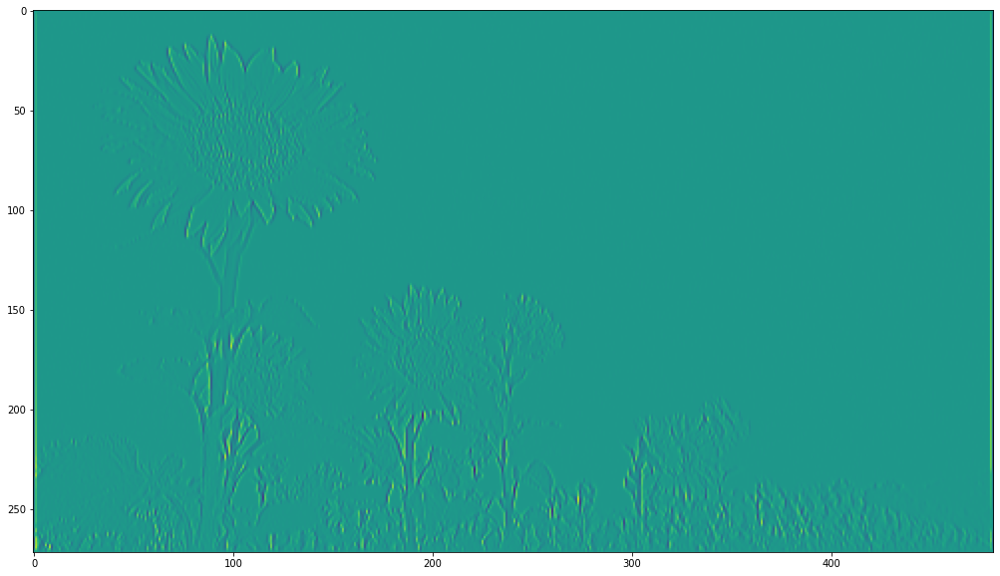

In [67]:
kernelY = [
    [ -1, -2, -1],
    [  2,  4,  2],
    [ -1, -2, -1]]

  

resY = signal.convolve2d(cv2.cvtColor(img, cv2.COLOR_BGR2GRAY), kernelY)
fig = plt.figure(figsize=(30,10))
plt.imshow(resY)

kernelX = [
    [ -1, 2, -1],
    [ -2, 4, -2],
    [ -1, 2, -1]]



resX = signal.convolve2d(cv2.cvtColor(img, cv2.COLOR_BGR2GRAY), kernelX)
fig = plt.figure(figsize=(30,10))
plt.imshow(resX)

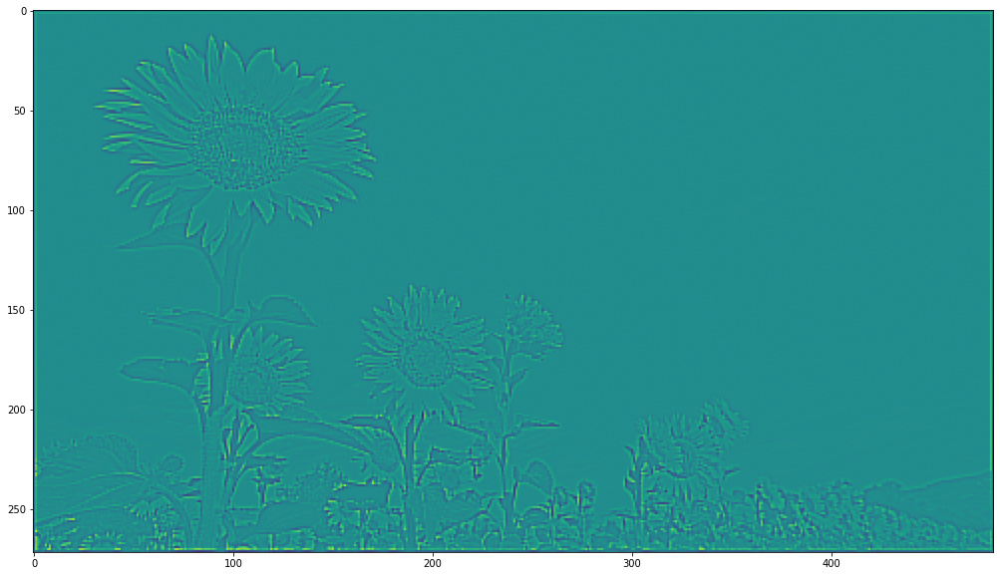

In [68]:
resT = resX + resY
fig = plt.figure(figsize=(30,10))
plt.imshow(resT)

(270, 480)
2860


/tmp/ipykernel_5097/1798573831.py:6: RuntimeWarning: divide by zero encountered in log10
  plt.imshow(np.log10(res4))


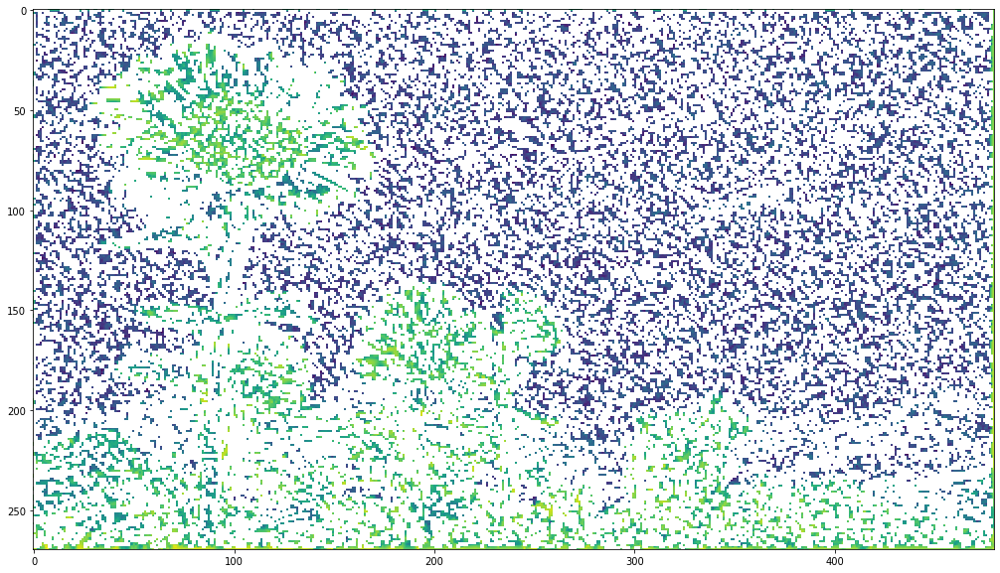

In [69]:
res4 = find_zero_crossings(resT)

print(np.max(res4))

fig = plt.figure(figsize=(30,10))
plt.imshow(np.log10(res4))


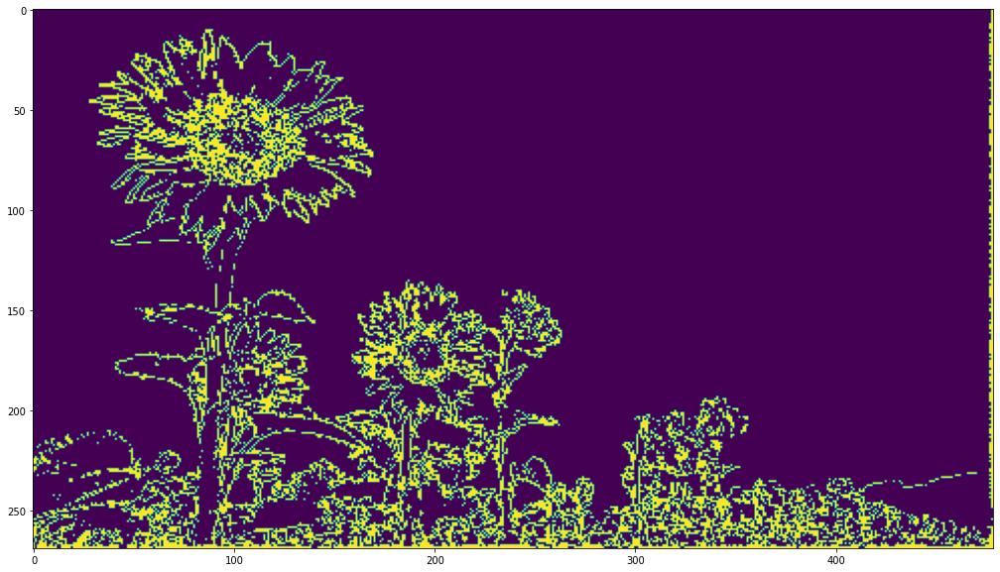

In [70]:
#res2 = np.asarray(res2)
res5 = [[1 if res4[i][j] > 250.0 else 0 for j in range(1, res4.shape[1])] for i in range(1, res4.shape[0])]
fig = plt.figure(figsize=(30,10))
plt.imshow(res5)

### Canny Edge Detector

Criteria for good edge detection:

1. Detection: minimise false positives (detecting an edge where there is none) and false negatives (missing an edge)
2. Localization: detected edges must be as close as possible to real edges
3. Single response constraint: only a single point should be returned for each edge point

Steps:

1. Smooth image with Gaussian filter
2. Compute derivative of image
3. Compute magnitude and orientation of gradient
4. Non-maximum supression (along gradient direction)
   - This is an important different relative to previous methods, as those explored the directions along the main axis
5. Hysteresis Threshold
   - Points with intensity above an upper threshold are considered edge pixels
   - Points bellow a lower threshold are considered non-edge pixels
   - Points between the threshold are considered edge pixels if they are connected to edge pixels. This is an iterative process




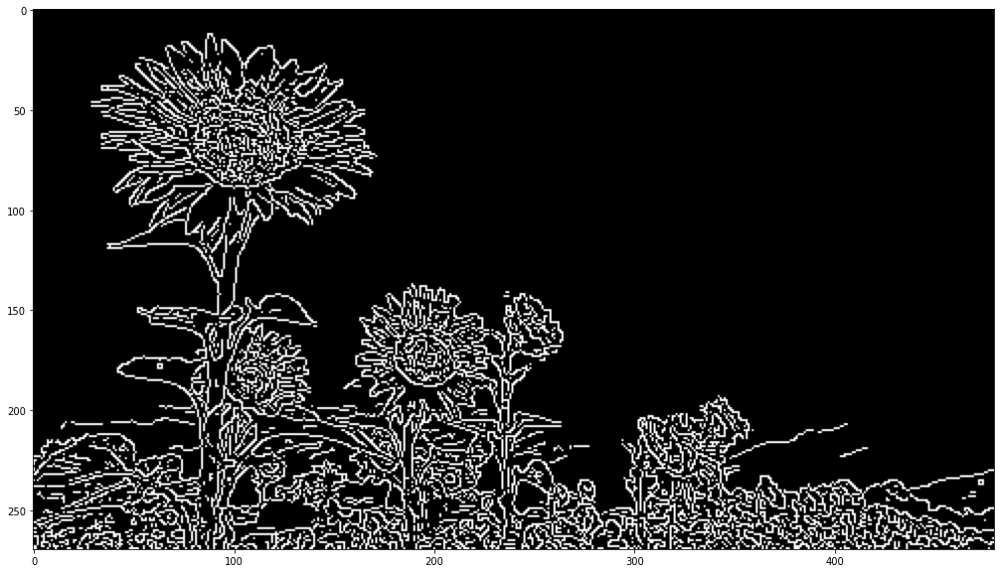

In [71]:
res = cv2.Canny(img, 70, 90)
fig = plt.figure(figsize=(30,10))
plt.imshow(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))